# Importing Libraries

In [1]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns
# plt.style.use('fivethirtyeight')
# sns.set()

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn import metrics

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
# from sklearn.decomposition import PCA
import plotly.express as px

In [2]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
import numpy as np
from scipy.io import loadmat
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt 
import numpy as np 
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")

# Loading Data

In [3]:
dataset = pd.read_csv('nasaBattery.csv')

In [4]:
dataset.shape

(185721, 11)

# Data Wrangling

In [5]:
dataset["datetime"] = pd.to_datetime(dataset["datetime"],format="%Y-%m-%d %H:%M:%S")

In [6]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 185721 entries, 0 to 185720
Data columns (total 11 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   cycle                 185721 non-null  int64         
 1   ambient_temperature   185721 non-null  int64         
 2   datetime              185721 non-null  datetime64[ns]
 3   capacity              185721 non-null  float64       
 4   voltage_measured      185721 non-null  float64       
 5   current_measured      185721 non-null  float64       
 6   temperature_measured  185721 non-null  float64       
 7   current_load          185721 non-null  float64       
 8   voltage_load          185721 non-null  float64       
 9   time                  185721 non-null  float64       
 10  batteryID             185721 non-null  int64         
dtypes: datetime64[ns](1), float64(7), int64(3)
memory usage: 15.6 MB


In [7]:
dataset['addTime'] = pd.to_datetime(dataset["time"], unit="s")

In [8]:
dataset['hour'] = pd.DatetimeIndex(dataset['addTime']).hour
dataset['min'] = pd.DatetimeIndex(dataset['addTime']).minute
dataset['sec'] = pd.DatetimeIndex(dataset['addTime']).second

In [9]:
from datetime import timedelta

for i,c in dataset.iterrows():
    dataset.loc[i,'curTime'] = dataset.loc[i,'datetime'] + np.timedelta64(dataset.loc[i,'hour'], 'h') + np.timedelta64(dataset.loc[i,'min'], 'm') + np.timedelta64(dataset.loc[i,'sec'], 's')

### Data engineering the datetime column

In [10]:
feature_window = 5

In [11]:
tempd = dataset.copy()

tempd['C'] = tempd['curTime'] - tempd['datetime']
tempd['timeSinceSensorstart'] = tempd['C'] / np.timedelta64(1, 'm')

tempd['too_soon'] = np.where((tempd.timeSinceSensorstart < feature_window) , 1, np.where((tempd.timeSinceSensorstart > 62) , 1, 0))

In [12]:
tempd['voltm_mean'] = np.where((tempd.too_soon == 0),(tempd['voltage_measured'].rolling(min_periods=1, window=feature_window).mean()) , tempd.voltage_measured)
tempd['voltm_median'] = np.where((tempd.too_soon == 0),(tempd['voltage_measured'].rolling(min_periods=1, window=feature_window).median()) , tempd.voltage_measured)
tempd['voltm_chg'] = np.where((tempd.voltm_mean == 0),0 , tempd.voltage_measured/tempd.voltm_mean)

In [13]:
tempd['currm_mean'] = np.where((tempd.too_soon == 0),(tempd['current_measured'].rolling(min_periods=1, window=feature_window).mean()) , tempd.current_measured)
tempd['currm_median'] = np.where((tempd.too_soon == 0),(tempd['current_measured'].rolling(min_periods=1, window=feature_window).median()) , tempd.current_measured)
tempd['currm_chg'] = np.where((tempd.currm_mean == 0),0 , tempd.current_measured/tempd.currm_mean)

In [14]:
tempd['tempm_mean'] = np.where((tempd.too_soon == 0),(tempd['temperature_measured'].rolling(min_periods=1, window=feature_window).mean()) , tempd.temperature_measured)
tempd['tempm_median'] = np.where((tempd.too_soon == 0),(tempd['temperature_measured'].rolling(min_periods=1, window=feature_window).median()) , tempd.temperature_measured)
tempd['tempm_chg'] = np.where((tempd.currm_mean == 0),0 , tempd.temperature_measured/tempd.tempm_mean)

In [15]:
tempd.count()

cycle                   185721
ambient_temperature     185721
datetime                185721
capacity                185721
voltage_measured        185721
current_measured        185721
temperature_measured    185721
current_load            185721
voltage_load            185721
time                    185721
batteryID               185721
addTime                 185721
hour                    185721
min                     185721
sec                     185721
curTime                 185721
C                       185721
timeSinceSensorstart    185721
too_soon                185721
voltm_mean              185721
voltm_median            185721
voltm_chg               185721
currm_mean              185721
currm_median            185721
currm_chg               185721
tempm_mean              185721
tempm_median            185721
tempm_chg               185721
dtype: int64

In [16]:
tmp1 = tempd[tempd['cycle']==50285]
tmp1['finalDate'] = tmp1['datetime']
tmp1 = tmp1[['finalDate']]
tmp1

,finalDate
50284,2008-05-27 20:45:42
100569,2008-05-27 20:45:42
150854,2008-05-27 20:45:42


In [17]:
tmp2 = tempd[(tempd['cycle']==34866)&(tempd['batteryID']==4)]
tmp2['finalDate'] = tmp2['datetime']
tmp2 = tmp2[['finalDate']]
tmp2

,finalDate
185720,2008-08-20 08:37:19


In [18]:
tmpfinal = pd.concat([tmp1, tmp2], axis=0)
tmpfinal

,finalDate
50284,2008-05-27 20:45:42
100569,2008-05-27 20:45:42
150854,2008-05-27 20:45:42
185720,2008-08-20 08:37:19


In [19]:
tmpwow = pd.merge(tempd, tmpfinal, how='left',left_index=True, right_index=True,)

In [20]:
tmpwow.fillna(inplace=True,method='bfill')

In [21]:
tmpwow.isna().sum()

cycle                   0
ambient_temperature     0
datetime                0
capacity                0
voltage_measured        0
current_measured        0
temperature_measured    0
current_load            0
voltage_load            0
time                    0
batteryID               0
addTime                 0
hour                    0
min                     0
sec                     0
curTime                 0
C                       0
timeSinceSensorstart    0
too_soon                0
voltm_mean              0
voltm_median            0
voltm_chg               0
currm_mean              0
currm_median            0
currm_chg               0
tempm_mean              0
tempm_median            0
tempm_chg               0
finalDate               0
dtype: int64

In [22]:
tmpwow['C1'] = tmpwow['finalDate'] - tmpwow['datetime']
tmpwow['days_to_fail'] = tmpwow['C1'] / np.timedelta64(1, 'D')

In [23]:
tmpwow.shape[1]

31

In [24]:
tempd.shape[1]

28

In [25]:
dataset = tmpwow.copy()
dataset = dataset.drop(['C','curTime','hour','min','sec','addTime','too_soon','timeSinceSensorstart','ambient_temperature','C1','finalDate'],axis=1)

In [26]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 185721 entries, 0 to 185720
Data columns (total 20 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   cycle                 185721 non-null  int64         
 1   datetime              185721 non-null  datetime64[ns]
 2   capacity              185721 non-null  float64       
 3   voltage_measured      185721 non-null  float64       
 4   current_measured      185721 non-null  float64       
 5   temperature_measured  185721 non-null  float64       
 6   current_load          185721 non-null  float64       
 7   voltage_load          185721 non-null  float64       
 8   time                  185721 non-null  float64       
 9   batteryID             185721 non-null  int64         
 10  voltm_mean            185721 non-null  float64       
 11  voltm_median          185721 non-null  float64       
 12  voltm_chg             185721 non-null  float64       
 13 

# EDA

In [27]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 185721 entries, 0 to 185720
Data columns (total 20 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   cycle                 185721 non-null  int64         
 1   datetime              185721 non-null  datetime64[ns]
 2   capacity              185721 non-null  float64       
 3   voltage_measured      185721 non-null  float64       
 4   current_measured      185721 non-null  float64       
 5   temperature_measured  185721 non-null  float64       
 6   current_load          185721 non-null  float64       
 7   voltage_load          185721 non-null  float64       
 8   time                  185721 non-null  float64       
 9   batteryID             185721 non-null  int64         
 10  voltm_mean            185721 non-null  float64       
 11  voltm_median          185721 non-null  float64       
 12  voltm_chg             185721 non-null  float64       
 13 

In [28]:
dataset.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
cycle,185721.0,23695.670797,14115.216705,1.000000,11608.000000,23216.000000,34823.000000,50285.000000
capacity,185721.0,1.574863,0.190633,1.153818,1.426025,1.559634,1.741850,2.035338
voltage_measured,185721.0,3.497219,0.251691,1.737030,3.377653,3.500859,3.655751,4.233325
current_measured,185721.0,-1.832569,0.561405,-2.029098,-2.011418,-2.009015,-1.989974,0.014306
temperature_measured,185721.0,32.378997,4.027737,22.350256,29.570621,32.355737,35.420677,42.332522
current_load,185721.0,1.465434,1.226874,-2.000000,1.998200,1.998800,1.999000,2.000000
voltage_load,185721.0,2.366494,0.751377,0.000000,2.410000,2.558000,2.718000,4.249000
time,185721.0,1546.379935,906.958628,0.000000,764.797000,1537.031000,2307.485000,3690.234000
batteryID,185721.0,2.375466,1.073068,1.000000,1.000000,2.000000,3.000000,4.000000
voltm_mean,185721.0,3.500663,0.248781,2.348451,3.379628,3.503089,3.661014,4.233325


### Cycles

In [29]:
cycles = pd.Series(dataset.groupby(['batteryID','datetime'])['cycle'].count()).to_frame()
cycles.reset_index(inplace=True,drop=False)
cycles.groupby(['batteryID']).sum()

,cycle
batteryID,
1,50285
2,50285
3,50285
4,34866


In [30]:
#no. of recordings taken(cycles each time the sensors are switched on)

### Datetime and time

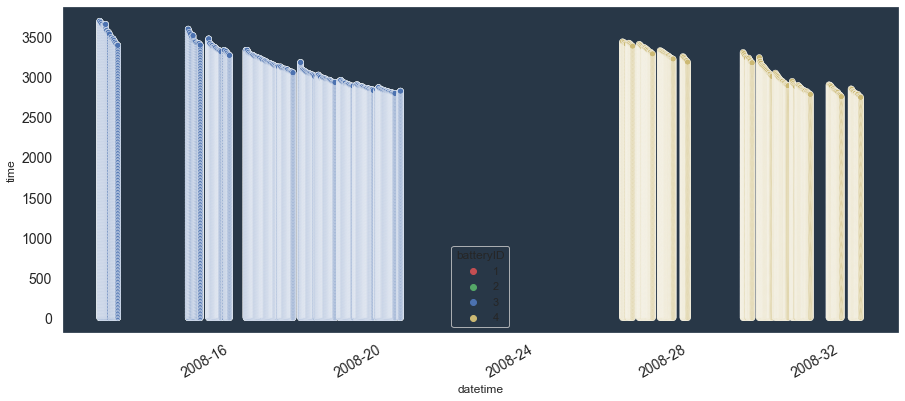

In [31]:
plt.figure(figsize=(15,6))
sns.set(rc={"axes.facecolor":"#283747", "axes.grid":False,'xtick.labelsize':14,'ytick.labelsize':14})
ax = sns.scatterplot(x = 'datetime', y = 'time', data = dataset,hue='batteryID',palette = ['r','g','b','y'])
plt.xticks(text = ax.xaxis.get_label(), fontsize = 14, rotation = 30)

date_format = mdates.DateFormatter('%Y-%W')
ax.xaxis.set_major_formatter(date_format)
ax.xaxis.set_major_locator(mdates.WeekdayLocator(interval = 4))

plt.show()

It seems as if the first 3 batteries are recorded together as they all also have the same cycles and overlap each other on the plot above . Let's verify this hypothesis

In [32]:
# Index value also counts for .equals

if(dataset[dataset['batteryID']==1][['datetime','time']].equals(dataset[dataset['batteryID']==2][['datetime','time']].reset_index(drop=True))):
    if(dataset[dataset['batteryID']==2][['datetime','time']].reset_index(drop=True).equals(dataset[dataset['batteryID']==3][['datetime','time']].reset_index(drop=True))):
        print("Hypothesis is valid ! ")
    else:
        print("Hypothesis is invalid ! ")
else:
    print("Hypothesis is invalid ! ")

Hypothesis is valid ! 


In [33]:
dataset['time'].max() # This is equal to the number of seconds in an hour

3690.234

From the data we are able to esatblish a very clear format of how these values are recorded . Its natural that the sensors aren't recording all the time . These are the characteristics of the conclusions drawn from the data above :

+ The *cycles* column represent the no. of sensors recording i.e. each cycle , a new sensor recording is taken .
+ The *datetime* column represent the exact time for which the sensors were switched on for an hour . Why an hour ? the time column extends mostly to 3600 in most cases of datetime values which means that at each datetime stamp the sensors are switched on, they only record until the next hour and the cycles of each values are recorded.
+ The *time* column represent the seconds elapsed since the sensors are switched on .
+ The sensors are automatically switched after 1 hour and the cycles pause ( no new recordings being taken ) .

In [34]:
####################################

# Voltage

<AxesSubplot:title={'center':'KDE Plot (Shaded Area Under the Curve)'}, xlabel='voltage_load', ylabel='Density'>

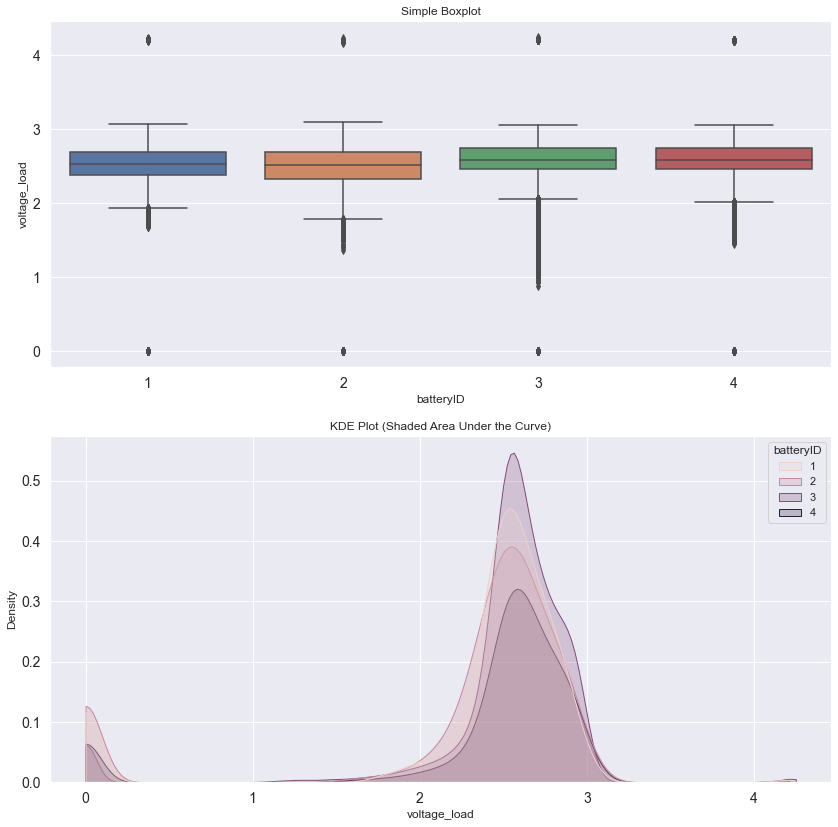

In [35]:
sns.set_style("darkgrid")
fig1 , axes = plt.subplots(nrows=2,ncols=1 , figsize = (14,14))

axes[0].set_title("Simple Boxplot")
sns.boxplot(dataset['batteryID'],dataset['voltage_load'],ax=axes[0])
# Shade under the density curve using the "shade" parameter
axes[1].set_title("KDE Plot (Shaded Area Under the Curve)")
sns.kdeplot(dataset['voltage_load'],color = 'r',shade=True,cut=0,ax=axes[1],hue=dataset['batteryID'])

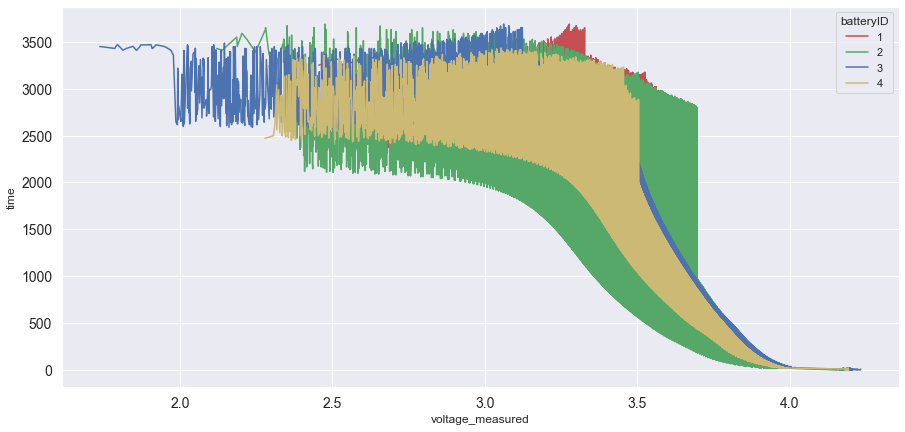

In [36]:
plt.figure(figsize=(15, 7))
sns.lineplot(x = 'voltage_measured', y = 'time', data = dataset, palette = ['r','g','b','y'], hue = 'batteryID')
plt.show()

In [37]:
len(dataset[dataset['batteryID']==1]['datetime'].value_counts())

168

In [38]:
import colorsys

def spectrum(n : int):
    hsv = [(h, 1, 1) for h in np.linspace(0, 240/360, n)]
    rgb = [colorsys.hsv_to_rgb(*tup) for tup in hsv]
    defloat = lambda x: tuple((int(255 * i) for i in x))
    return [defloat(x) for x in rgb]

def rgb2hex(r,g,b):
    return "#{:02x}{:02x}{:02x}".format(r,g,b)

def getPlt(n):
    bruh1 = spectrum(n)
    pal = []
    for i in range(n):
        pal.append(rgb2hex(int(bruh1[i][0]),int(bruh1[i][1]),int(bruh1[i][2])))
    return pal

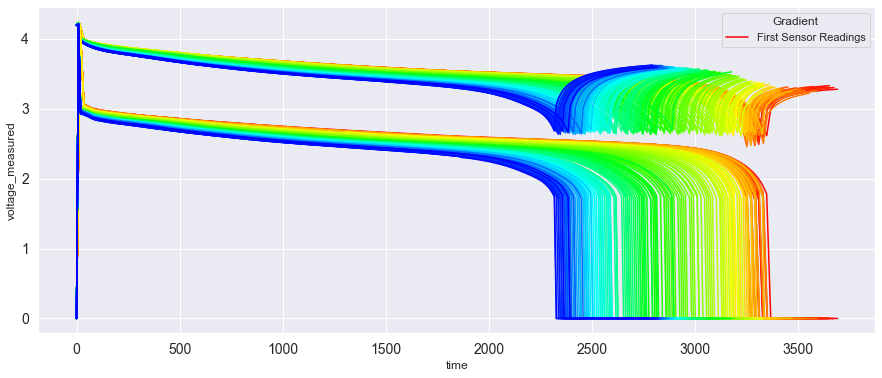

In [39]:
plt.figure(figsize=(15, 6))
st = sns.lineplot(x = 'time', y = 'voltage_measured', data = dataset[dataset['batteryID']==1], palette = getPlt(168),hue='datetime')
sns.lineplot(x = 'time', y = 'voltage_load', data = dataset[dataset['batteryID']==1], palette = getPlt(168),hue='datetime')
plt.legend(title='Gradient', loc='upper right', labels=['First Sensor Readings'])
plt.show()

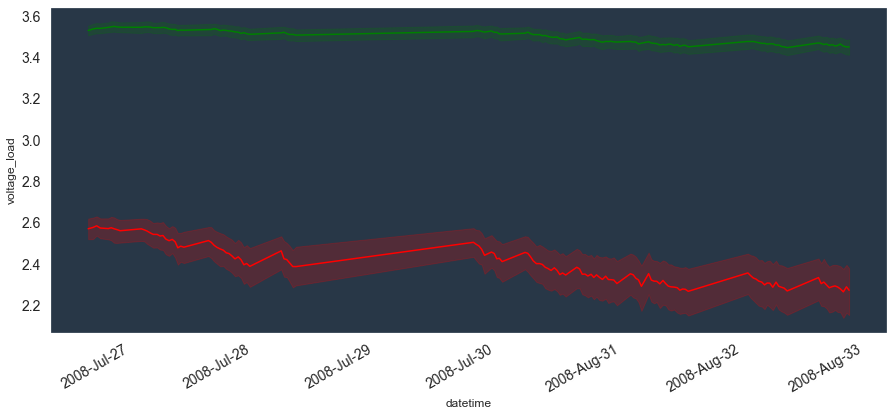

In [40]:
# Displaying Lineplot without outliers

plt.figure(figsize=(15,6))
sns.set(rc={"axes.facecolor":"#283747", "axes.grid":False,'xtick.labelsize':14,'ytick.labelsize':14})
ax = sns.lineplot(x = 'datetime', y = 'voltage_load', data = dataset[dataset['batteryID']==4],color='red')
sns.lineplot(x = 'datetime', y = 'voltage_measured', data = dataset[dataset['batteryID']==4],color='green')
plt.xticks(text = ax.xaxis.get_label(), fontsize = 14, rotation = 30)

date_format = mdates.DateFormatter('%Y-%b-%W')
ax.xaxis.set_major_formatter(date_format)
ax.xaxis.set_major_locator(mdates.WeekdayLocator(interval = 1))

plt.show()

# Temperature

<AxesSubplot:title={'center':'KDE Plot (Shaded Area Under the Curve)'}, xlabel='temperature_measured', ylabel='Density'>

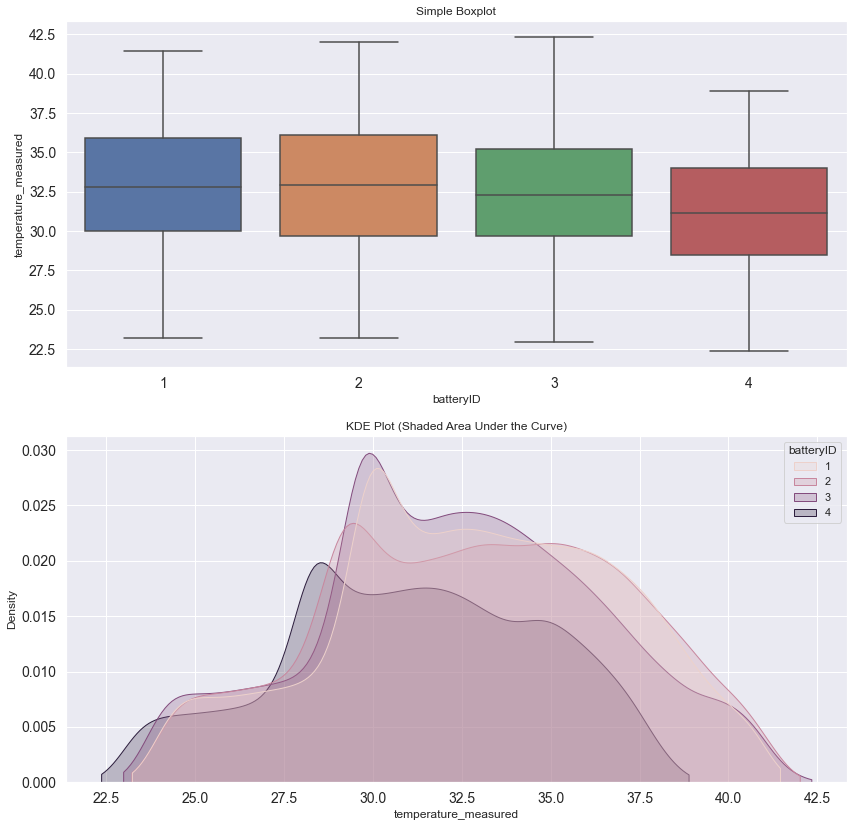

In [41]:
sns.set_style("darkgrid")
fig1 , axes = plt.subplots(nrows=2,ncols=1 , figsize = (14,14))

axes[0].set_title("Simple Boxplot")
sns.boxplot(dataset['batteryID'],dataset['temperature_measured'],ax=axes[0])
# Shade under the density curve using the "shade" parameter
axes[1].set_title("KDE Plot (Shaded Area Under the Curve)")
sns.kdeplot(dataset['temperature_measured'],color = 'r',shade=True,cut=0,ax=axes[1],hue=dataset['batteryID'])

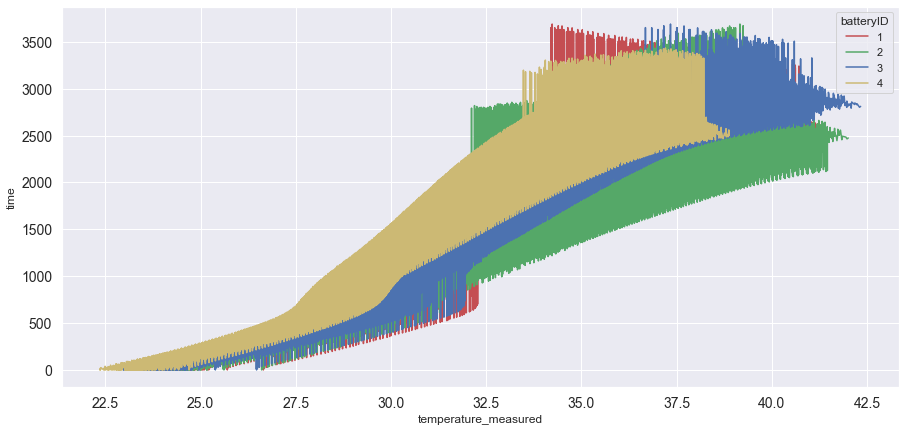

In [42]:
plt.figure(figsize=(15, 7))
sns.lineplot(x = 'temperature_measured', y = 'time', data = dataset, palette = ['r','g','b','y'], hue = 'batteryID')
plt.show()

# Current

<AxesSubplot:title={'center':'KDE Plot (Shaded Area Under the Curve)'}, xlabel='current_measured', ylabel='Density'>

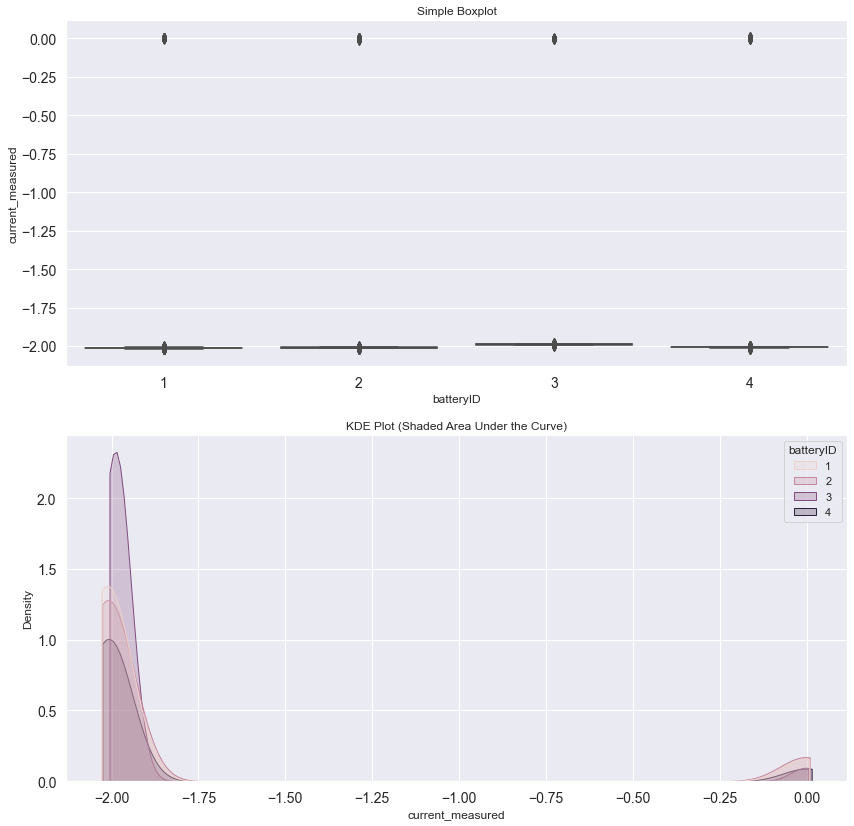

In [43]:
sns.set_style("darkgrid")
fig1 , axes = plt.subplots(nrows=2,ncols=1 , figsize = (14,14))

axes[0].set_title("Simple Boxplot")
sns.boxplot(dataset['batteryID'],dataset['current_measured'],ax=axes[0])
# Shade under the density curve using the "shade" parameter
axes[1].set_title("KDE Plot (Shaded Area Under the Curve)")
sns.kdeplot(dataset['current_measured'],color = 'r',shade=True,cut=0,ax=axes[1],hue=dataset['batteryID'])

# Capacity

<AxesSubplot:title={'center':'KDE Plot (Shaded Area Under the Curve)'}, xlabel='capacity', ylabel='Density'>

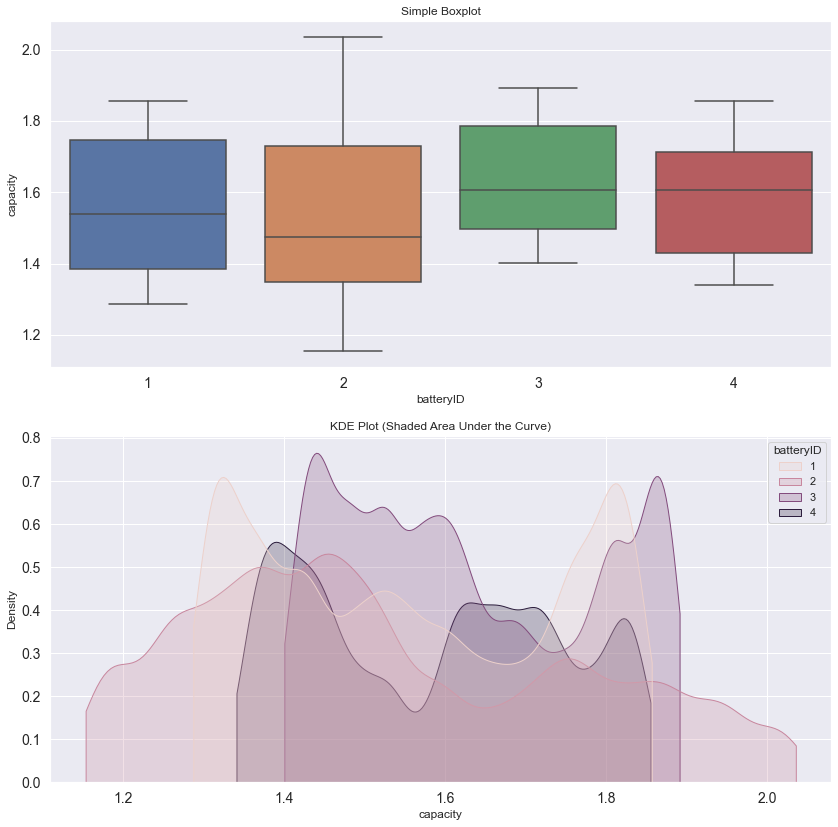

In [44]:
sns.set_style("darkgrid")
fig1 , axes = plt.subplots(nrows=2,ncols=1 , figsize = (14,14))

axes[0].set_title("Simple Boxplot")
sns.boxplot(dataset['batteryID'],dataset['capacity'],ax=axes[0])
# Shade under the density curve using the "shade" parameter
axes[1].set_title("KDE Plot (Shaded Area Under the Curve)")
sns.kdeplot(dataset['capacity'],color = 'r',shade=True,cut=0,ax=axes[1],hue=dataset['batteryID'])

In [45]:
dataset['datetime'][0]

Timestamp('2008-04-02 15:25:41')

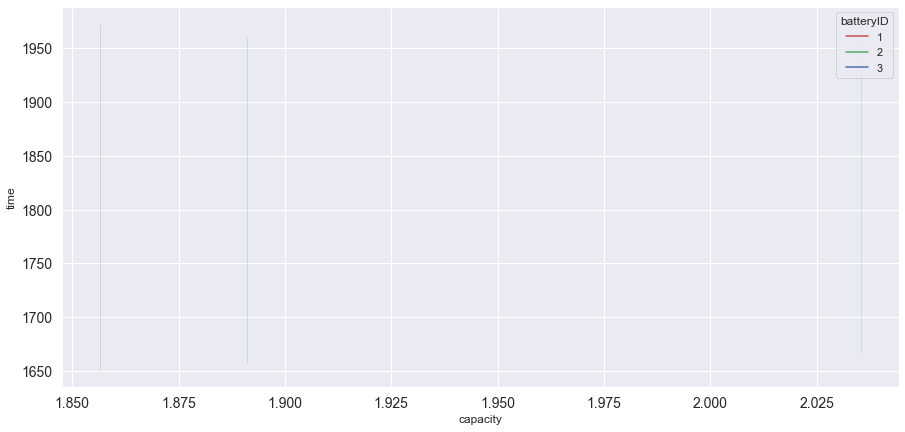

In [46]:
plt.figure(figsize=(15, 7))
sns.lineplot(x = 'capacity', y = 'time', data = dataset[dataset['datetime']=='2008-04-02 15:25:41'], palette = ['r','g','b'], hue = 'batteryID')
plt.show()

In [47]:
tempd = dataset.copy().groupby(['batteryID','datetime','capacity']).count()
tempd

cycle  voltage_measured  \
batteryID datetime            capacity                            
1         2008-04-02 15:25:41 1.856487    197               197   
          2008-04-02 19:43:48 1.846327    196               196   
          2008-04-03 00:01:06 1.835349    195               195   
          2008-04-03 04:16:37 1.835263    194               194   
          2008-04-03 08:33:25 1.834646    194               194   
...                                       ...               ...   
4         2008-08-19 16:54:51 1.362737    204               204   
          2008-08-19 20:32:20 1.363405    204               204   
          2008-08-20 00:43:05 1.351865    202               202   
          2008-08-20 05:02:00 1.354797    201               201   
          2008-08-20 08:37:19 1.341051    200               200   

                                        current_measured  \
batteryID datetime            capacity                     
1         2008-04-02 15:25:41 1.856487               197   
          2008-04-02 19:43:48 1.846327               196   
          2008-04-03 00:01:06 1.835349               195   
          2008-04-03 04:16:37 1.835263               194   
          2008-04-03 08:33:25 1.834646               194   
...                                                  ...   
4         2008-08-19 16:54:51 1.362737               204   
          2008-08-19 20:32:20 1.363405               204   
          2008-08-20 00:43:05 1.351865               202   
          2008-08-20 05:02:00 1.354797               201   
          2008-08-20 08:37:19 1.341051               200   

                                        temperature_measured  current_load  \
batteryID datetime            capacity                                       
1         2008-04-02 15:25:41 1.856487                   197           197   
          2008-04-02 19:43:48 1.846327                   196           196   
          2008-04-03 00:01:06 1.835349                   195           195   
          2008-04-03 04:16:37 1.835263                   194           194   
          2008-04-03 08:33:25 1.834646                   194           194   
...                                                      ...           ...   
4         2008-08-19 16:54:51 1.362737                   204           204   
          2008-08-19 20:32:20 1.363405                   204           204   
          2008-08-20 00:43:05 1.351865                   202           202   
          2008-08-20 05:02:00 1.354797                   201           201   
          2008-08-20 08:37:19 1.341051                   200           200   

                                        voltage_load  time  voltm_mean  \
batteryID datetime            capacity                                   
1         2008-04-02 15:25:41 1.856487           197   197         197   
          2008-04-02 19:43:48 1.846327           196   196         196   
          2008-04-03 00:01:06 1.835349           195   195         195   
          2008-04-03 04:16:37 1.835263           194   194         194   
          2008-04-03 08:33:25 1.834646           194   194         194   
...                                              ...   ...         ...   
4         2008-08-19 16:54:51 1.362737           204   204         204   
          2008-08-19 20:32:20 1.363405           204   204         204   
          2008-08-20 00:43:05 1.351865           202   202         202   
          2008-08-20 05:02:00 1.354797           201   201         201   
          2008-08-20 08:37:19 1.341051           200   200         200   

                                        voltm_median  voltm_chg  currm_mean  \
batteryID datetime            capacity                                        
1         2008-04-02 15:25:41 1.856487           197        197         197   
          2008-04-02 19:43:48 1.846327           196        196         196   
          2008-04-03 00:01:06 1.835349           195        195         195   
          2008

In [48]:
len(dataset[dataset['batteryID']==4].value_counts('datetime'))

132

In [49]:
len(dataset[dataset['batteryID']==4].value_counts('capacity'))

132

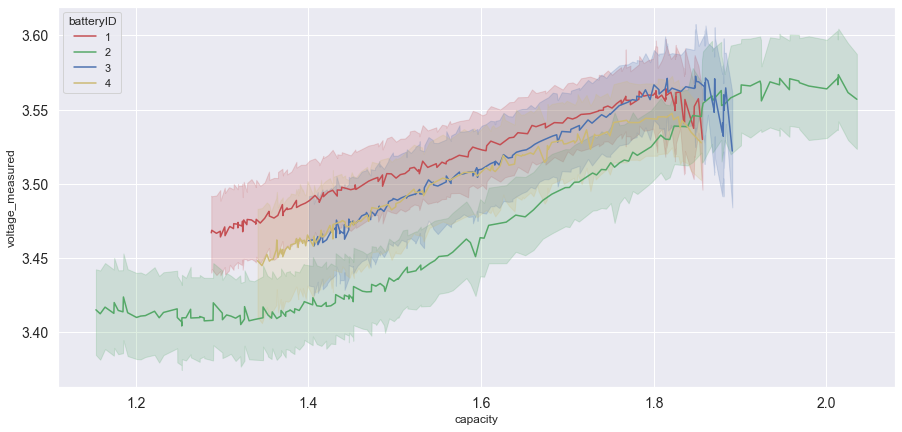

In [50]:
plt.figure(figsize=(15, 7))
sns.lineplot(x = 'capacity', y = 'voltage_measured', data = dataset, palette = ['r','g','b','y'], hue = 'batteryID')
plt.show()

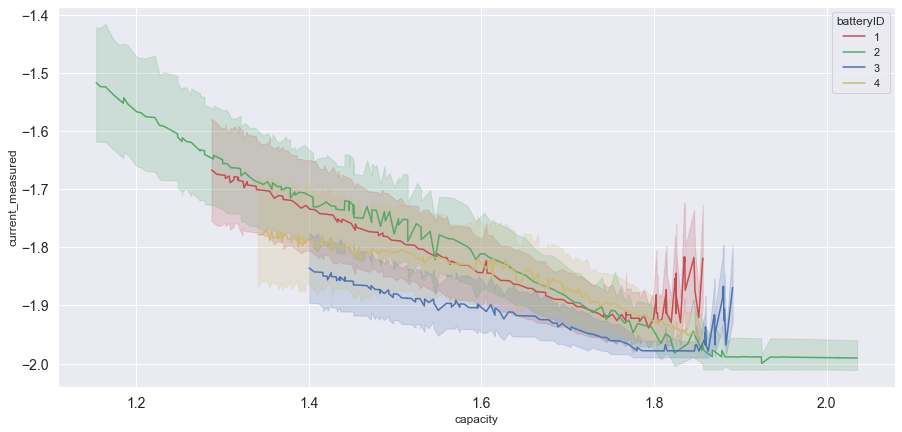

In [51]:
plt.figure(figsize=(15, 7))
sns.lineplot(x = 'capacity', y = 'current_measured', data = dataset, palette = ['r','g','b','y'], hue = 'batteryID')
plt.show()

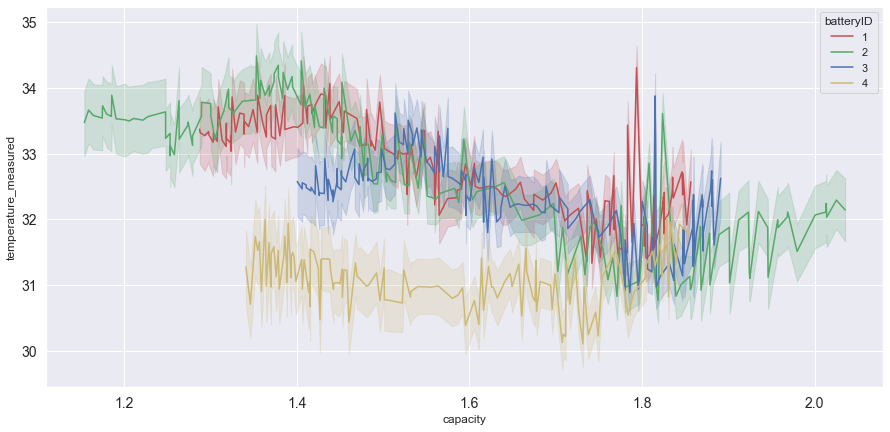

In [52]:
plt.figure(figsize=(15, 7))
sns.lineplot(x = 'capacity', y = 'temperature_measured', data = dataset, palette = ['r','g','b','y'], hue = 'batteryID')
plt.show()

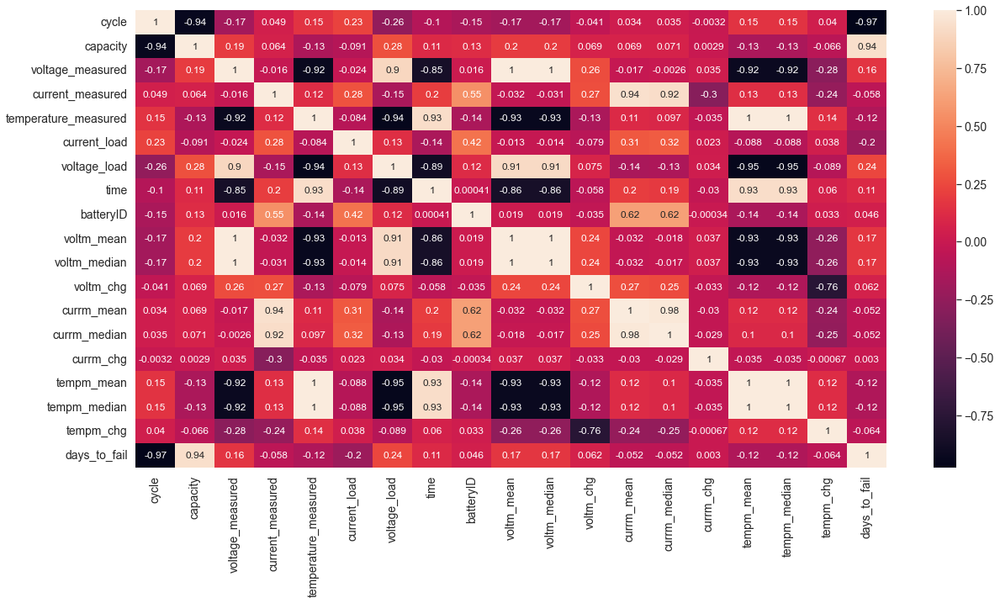

In [53]:
fig, ax = plt.subplots(figsize = (20,10))
sns.heatmap(dataset.corr(method = 'spearman'), annot = True)
plt.show()

<Figure size 1080x432 with 0 Axes>

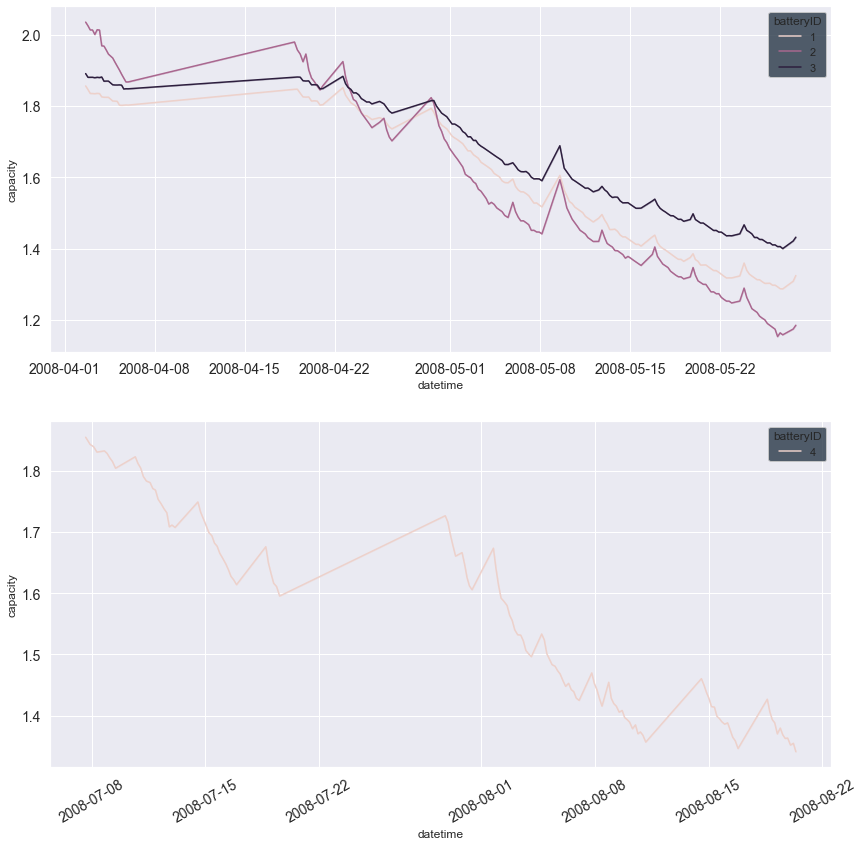

In [54]:
# Displaying Lineplot without outliers

plt.figure(figsize=(15,6))
fig1 , axes = plt.subplots(nrows=2,ncols=1 , figsize = (14,14))

sns.set(rc={"axes.facecolor":"#283747", "axes.grid":False,'xtick.labelsize':14,'ytick.labelsize':14})
sns.lineplot(x = 'datetime', y = 'capacity', data = dataset[~(dataset['batteryID']==4)],hue='batteryID',ax=axes[0])
sns.lineplot(x = 'datetime', y = 'capacity', data = dataset[(dataset['batteryID']==4)],hue='batteryID',ax=axes[1])
plt.xticks(text = ax.xaxis.get_label(), fontsize = 14, rotation = 30)

date_format = mdates.DateFormatter('%Y-%b-%W')
ax.xaxis.set_major_formatter(date_format)
ax.xaxis.set_major_locator(mdates.WeekdayLocator(interval = 1))

plt.show()

<Figure size 1080x432 with 0 Axes>

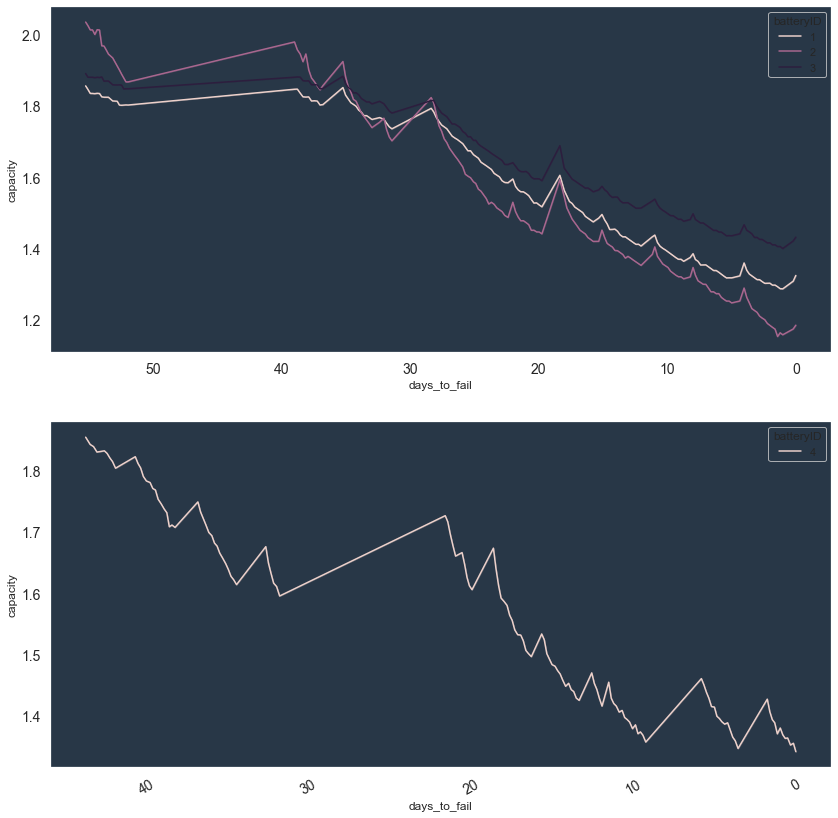

In [55]:
# Displaying Lineplot without outliers

plt.figure(figsize=(15,6))
fig1 , axes = plt.subplots(nrows=2,ncols=1 , figsize = (14,14))

#sns.set(rc={"axes.facecolor":"#283747", "axes.grid":False,'xtick.labelsize':14,'ytick.labelsize':14})
sns.lineplot(x = 'days_to_fail', y = 'capacity', data = dataset[~(dataset['batteryID']==4)],hue='batteryID',ax=axes[0])
sns.lineplot(x = 'days_to_fail', y = 'capacity', data = dataset[(dataset['batteryID']==4)],hue='batteryID',ax=axes[1])
plt.xticks(text = ax.xaxis.get_label(), fontsize = 14, rotation = 30)

axes[0].invert_xaxis()
axes[1].invert_xaxis()

date_format = mdates.DateFormatter('%Y-%b-%W')
ax.xaxis.set_major_formatter(date_format)
ax.xaxis.set_major_locator(mdates.WeekdayLocator(interval = 1))

plt.show()

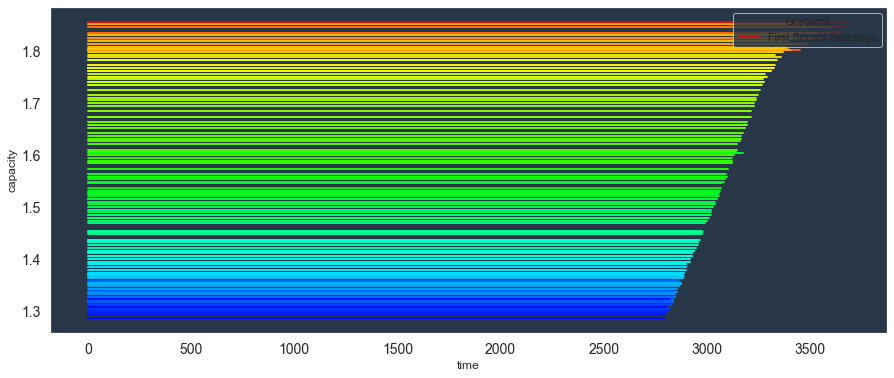

In [56]:
plt.figure(figsize=(15, 6))
st = sns.lineplot(x = 'time', y = 'capacity', data = dataset[dataset['batteryID']==1], palette = getPlt(168),hue='datetime')
sns.lineplot(x = 'time', y = 'capacity', data = dataset[dataset['batteryID']==1], palette = getPlt(168),hue='datetime')
plt.legend(title='Gradient', loc='upper right', labels=['First Sensor Readings'])
plt.show()

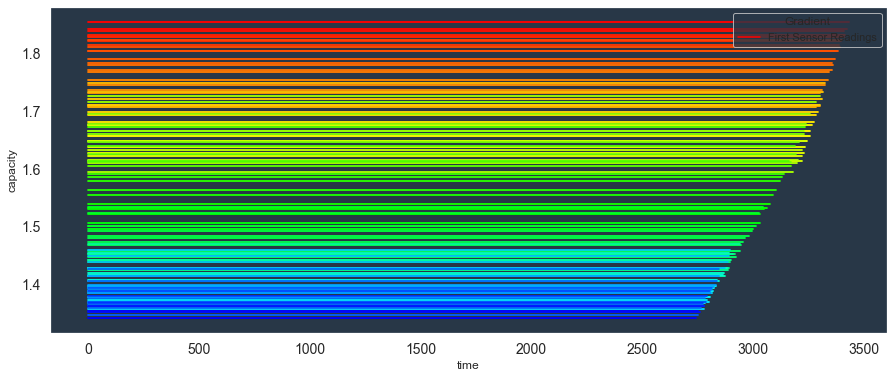

In [57]:
plt.figure(figsize=(15, 6))
st = sns.lineplot(x = 'time', y = 'capacity', data = dataset[dataset['batteryID']==4], palette = getPlt(132),hue='datetime')
sns.lineplot(x = 'time', y = 'capacity', data = dataset[dataset['batteryID']==4], palette = getPlt(132),hue='datetime')
plt.legend(title='Gradient', loc='upper right', labels=['First Sensor Readings'])
plt.show()

# Anomaly Detection

In [58]:
dataset = dataset.astype({"batteryID":"str"})
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 185721 entries, 0 to 185720
Data columns (total 20 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   cycle                 185721 non-null  int64         
 1   datetime              185721 non-null  datetime64[ns]
 2   capacity              185721 non-null  float64       
 3   voltage_measured      185721 non-null  float64       
 4   current_measured      185721 non-null  float64       
 5   temperature_measured  185721 non-null  float64       
 6   current_load          185721 non-null  float64       
 7   voltage_load          185721 non-null  float64       
 8   time                  185721 non-null  float64       
 9   batteryID             185721 non-null  object        
 10  voltm_mean            185721 non-null  float64       
 11  voltm_median          185721 non-null  float64       
 12  voltm_chg             185721 non-null  float64       
 13 

# IQR Method

In [59]:
voltage_col = ['voltage_load', 'voltage_measured','voltm_mean','voltm_median']
current_col= ['current_load','current_measured','currm_mean','currm_median']
temp_col = ['temperature_measured','tempm_mean','tempm_median']
cycle_col = ['cycle']
time_col = ['time','days_to_fail']
cap_col = ['capacity']
Q1 = dataset.quantile(0.25)
Q3 = dataset.quantile(0.75)
IQR = Q3 - Q1
print(IQR)

cycle                   23215.000000
capacity                    0.315825
voltage_measured            0.278098
current_measured            0.021444
temperature_measured        5.850056
current_load                0.000800
voltage_load                0.308000
time                     1542.688000
voltm_mean                  0.281387
voltm_median                0.281163
voltm_chg                   0.001033
currm_mean                  0.021615
currm_median                0.021560
currm_chg                   0.000869
tempm_mean                  5.868983
tempm_median                5.866828
tempm_chg                   0.001980
days_to_fail               21.674329
dtype: float64


<Figure size 1080x432 with 0 Axes>

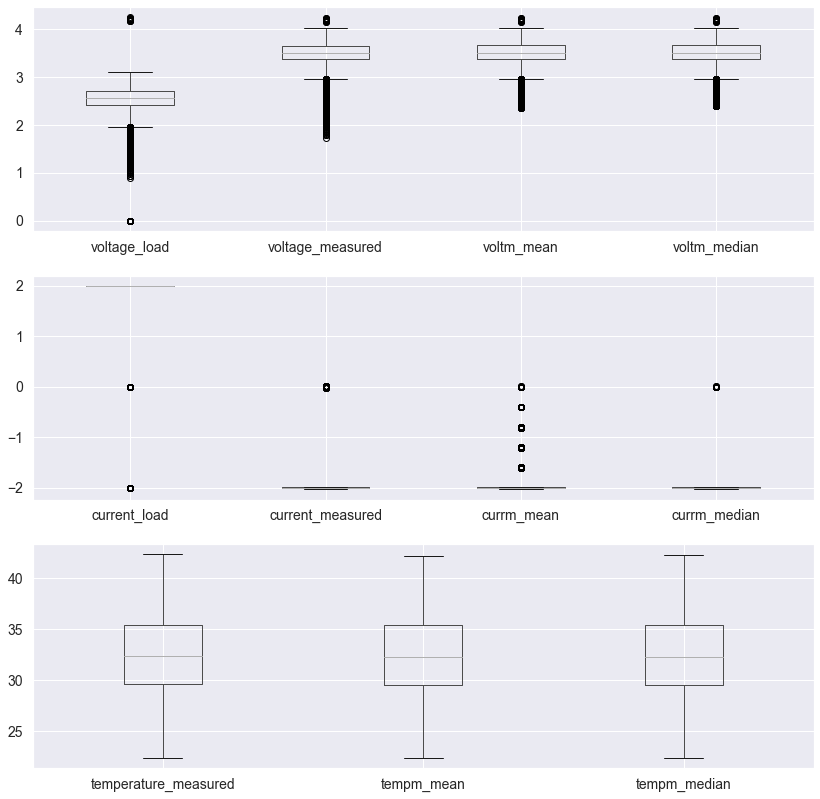

In [60]:
sns.set_style("darkgrid")
plt.figure(figsize=(15,6))
fig1 , axes = plt.subplots(nrows=3,ncols=1 , figsize = (14,14))

dataset[voltage_col].boxplot(ax = axes[0])
dataset[current_col].boxplot(ax = axes[1])
dataset[temp_col].boxplot(ax = axes[2])
plt.show()

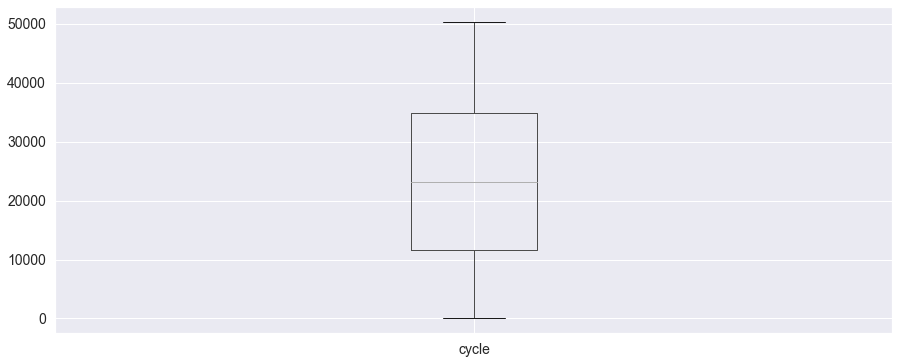

In [61]:
plt.figure(figsize=(15,6))
dataset[cycle_col].boxplot()
plt.show()

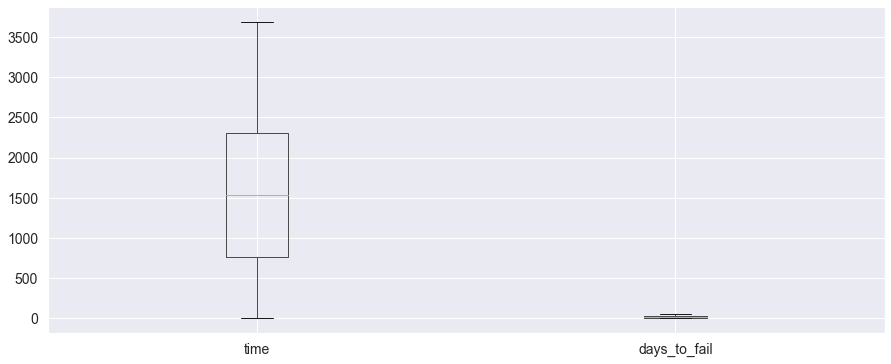

In [62]:
plt.figure(figsize=(15,6))
dataset[time_col].boxplot()
plt.show()

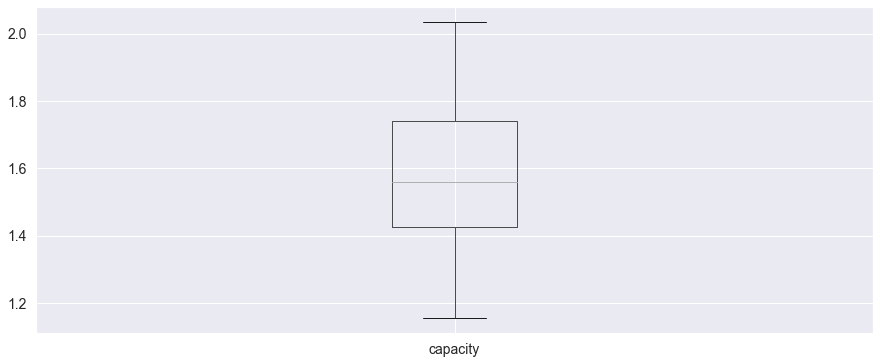

In [63]:
plt.figure(figsize=(15,6))
dataset[cap_col].boxplot()
plt.show()

In [64]:
num_cols = ['voltage_load', 'voltage_measured','voltm_mean','voltm_median','current_load','current_measured','currm_mean','currm_median','temperature_measured','tempm_mean','tempm_median']
dataset_IQR = dataset[~((dataset[num_cols] < (Q1 - 1.5*IQR)) | (dataset[num_cols] > (Q3 +1.5*IQR))).any(axis = 1)]
print("No. of instances removed : " + str(dataset.shape[0] - dataset_IQR.shape[0]))

No. of instances removed : 37766


In [65]:
highlighter = dataset_IQR.copy()
highlighter['Anom'] = 1

anomHighlight = dataset.copy()
anomHighlight = anomHighlight.merge(highlighter[['Anom']],how='outer',left_index=True, right_index=True)
anomHighlight = anomHighlight.fillna(-1)
anomHighlight.value_counts('Anom')

Anom
 1.0    147955
-1.0     37766
dtype: int64

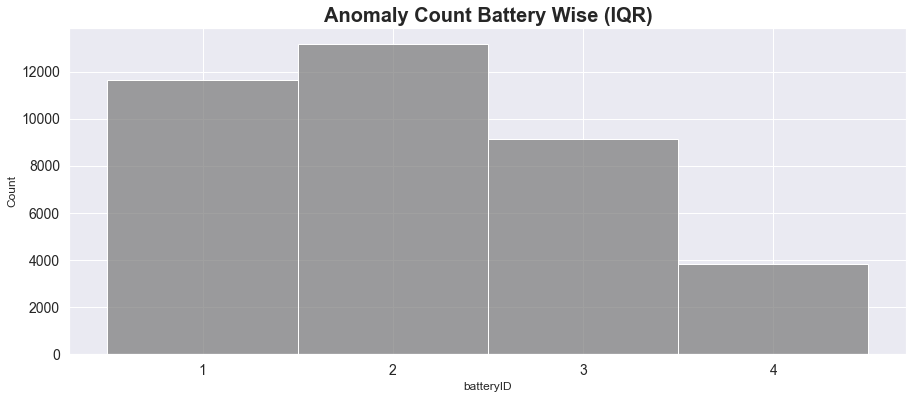

In [66]:
# Anomaly Count plot
plt.figure(figsize=(15,6))
sns.histplot(anomHighlight[anomHighlight['Anom'] == -1]['batteryID'],stat = "count",color='Grey')
plt.title('Anomaly Count Battery Wise (IQR)', fontsize = 20, fontweight = 'bold')
plt.show()

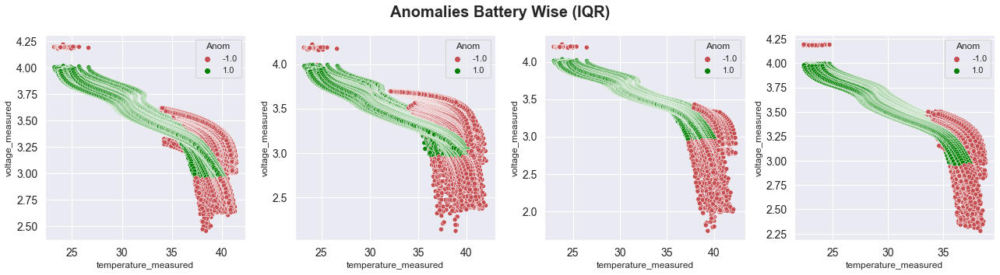

In [67]:
fig, axs = plt.subplots(1, 4, figsize = (18,5))
for i in range(5):
    if(i==0):
        continue
    sns.scatterplot(data = anomHighlight[anomHighlight['batteryID'] == str(i)],
                   x = 'temperature_measured', y = 'voltage_measured', alpha = 1,ax = axs[(i-1)],hue ='Anom',palette=['r','green'])           
    

fig.suptitle('Anomalies Battery Wise (IQR)', fontsize = 20, fontweight = 'bold')
plt.tight_layout()
plt.show()

In [90]:
fig = px.scatter_3d(anomHighlight[anomHighlight['batteryID']=="1"], x='temperature_measured', y='voltage_measured', z='time',
              color='Anom',color_continuous_scale=['red','green'])
fig.show()
# x='voltage_measured', y='temperature_measured'

## DBSCAN method

In [69]:
datasetDBSCAN = dataset.copy()
datasetDBSCAN.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 185721 entries, 0 to 185720
Data columns (total 20 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   cycle                 185721 non-null  int64         
 1   datetime              185721 non-null  datetime64[ns]
 2   capacity              185721 non-null  float64       
 3   voltage_measured      185721 non-null  float64       
 4   current_measured      185721 non-null  float64       
 5   temperature_measured  185721 non-null  float64       
 6   current_load          185721 non-null  float64       
 7   voltage_load          185721 non-null  float64       
 8   time                  185721 non-null  float64       
 9   batteryID             185721 non-null  object        
 10  voltm_mean            185721 non-null  float64       
 11  voltm_median          185721 non-null  float64       
 12  voltm_chg             185721 non-null  float64       
 13 

In [70]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn import metrics

cols = ['cycle', 'capacity', 'voltage_load', 'voltage_measured','voltm_mean','voltm_median','current_load','current_measured','currm_mean','currm_median','temperature_measured','tempm_mean','tempm_median', 'time', 'days_to_fail']
colswithoutalter = ['cycle', 'capacity', 'voltage_load', 'voltage_measured','current_load','current_measured','temperature_measured', 'time', 'days_to_fail']
colsWAB = ['cycle', 'capacity', 'voltage_load', 'voltage_measured','current_load','current_measured','temperature_measured', 'time', 'days_to_fail','batteryID']

#14000
#13000
#

std_scaler = StandardScaler().fit(datasetDBSCAN[cols])
std_df = std_scaler.transform(datasetDBSCAN[cols])

dbsc = DBSCAN(eps = .5, min_samples = 200).fit(std_df)


labels = dbsc.labels_


In [71]:
datasetDBSCAN['label'] = dbsc.labels_
datasetDBSCAN['label'].value_counts()

 2    148176
-1     14218
 0      9896
 3      7302
 1      5847
 4       282
Name: label, dtype: int64

In [72]:
datasetDBSCAN['label'] = np.where((datasetDBSCAN.label == -1),-1 , 1)
datasetDBSCAN['label'].value_counts()

 1    171503
-1     14218
Name: label, dtype: int64

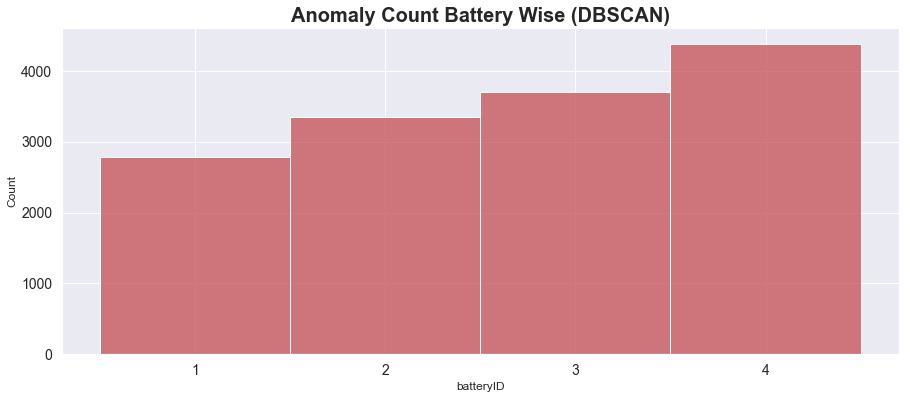

In [73]:
# Anomaly Count plot
plt.figure(figsize=(15,6))
sns.histplot(datasetDBSCAN[datasetDBSCAN['label'] == -1]['batteryID'],stat = "count",color='r')
plt.title('Anomaly Count Battery Wise (DBSCAN)', fontsize = 20, fontweight = 'bold')
plt.show()

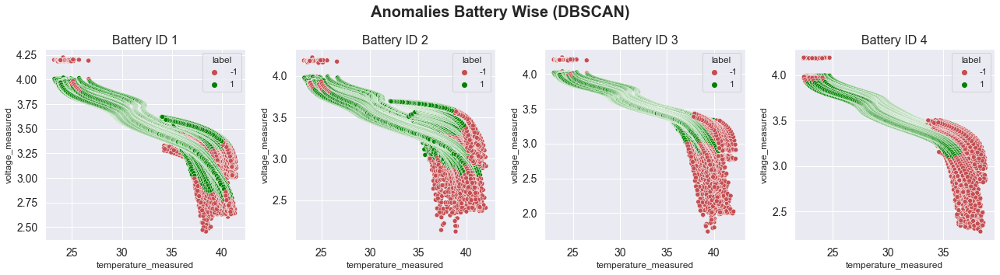

In [74]:
fig, axs = plt.subplots(1, 4, figsize = (18,5))
for i in range(5):
    if(i==0):
        continue
    sns.scatterplot(data = datasetDBSCAN[datasetDBSCAN['batteryID'] == str(i)],
                   x = 'temperature_measured', y = 'voltage_measured', alpha = 1,ax = axs[(i-1)],hue ='label',palette=['r','green'])           
    axs[i-1].set_title('Battery ID ' + str(i), fontsize = 16)

fig.suptitle('Anomalies Battery Wise (DBSCAN)', fontsize = 20, fontweight = 'bold')
plt.tight_layout()
plt.show()

In [75]:
fig = px.scatter_3d(datasetDBSCAN[datasetDBSCAN['batteryID']=="1"], x='temperature_measured', y='voltage_measured', z='time',
              color='label',color_continuous_scale=['red','green'])
fig.show()
# x='voltage_measured', y='temperature_measured'

In [76]:
['red','green','green','green','green','green']

['red', 'green', 'green', 'green', 'green', 'green']

# Isolation Forest 

In [77]:
cols = ['cycle', 'capacity', 'voltage_load', 'voltage_measured','voltm_mean','voltm_median','current_load','current_measured','currm_mean','currm_median','temperature_measured','tempm_mean','tempm_median', 'time', 'days_to_fail','batteryID']

In [78]:
datasetISO = dataset.copy()
datasetISO = datasetISO[cols]

In [79]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 185721 entries, 0 to 185720
Data columns (total 20 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   cycle                 185721 non-null  int64         
 1   datetime              185721 non-null  datetime64[ns]
 2   capacity              185721 non-null  float64       
 3   voltage_measured      185721 non-null  float64       
 4   current_measured      185721 non-null  float64       
 5   temperature_measured  185721 non-null  float64       
 6   current_load          185721 non-null  float64       
 7   voltage_load          185721 non-null  float64       
 8   time                  185721 non-null  float64       
 9   batteryID             185721 non-null  object        
 10  voltm_mean            185721 non-null  float64       
 11  voltm_median          185721 non-null  float64       
 12  voltm_chg             185721 non-null  float64       
 13 

In [80]:
datasetISO.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 185721 entries, 0 to 185720
Data columns (total 16 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   cycle                 185721 non-null  int64  
 1   capacity              185721 non-null  float64
 2   voltage_load          185721 non-null  float64
 3   voltage_measured      185721 non-null  float64
 4   voltm_mean            185721 non-null  float64
 5   voltm_median          185721 non-null  float64
 6   current_load          185721 non-null  float64
 7   current_measured      185721 non-null  float64
 8   currm_mean            185721 non-null  float64
 9   currm_median          185721 non-null  float64
 10  temperature_measured  185721 non-null  float64
 11  tempm_mean            185721 non-null  float64
 12  tempm_median          185721 non-null  float64
 13  time                  185721 non-null  float64
 14  days_to_fail          185721 non-null  float64
 15  

In [81]:
from sklearn.ensemble import IsolationForest
import matplotlib.pyplot as plt

flag_df = pd.DataFrame()
flag_df_final = pd.DataFrame()
for j in datasetISO['batteryID'].unique():
    contamination_arr = [0.01, 0.02, 0.03, 0.04,0.05]
    flag_df = datasetISO[datasetISO['batteryID'] == j]
    for i in contamination_arr:
        model = IsolationForest(n_estimators = 200, max_samples = 'auto', contamination = i, random_state = 42)
        flag_df['anomaly_score'+'_'+str(i)] = model.fit_predict(flag_df)
        flag_df['scores'+'_'+str(i)] = model.decision_function(flag_df[flag_df.columns.difference(['anomaly_score'+'_'+str(i)])])
    flag_df_final = pd.concat([flag_df,flag_df_final])

In [82]:
flag_df_final.info('')

<class 'pandas.core.frame.DataFrame'>
Int64Index: 185721 entries, 150855 to 50284
Data columns (total 26 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   cycle                 185721 non-null  int64  
 1   capacity              185721 non-null  float64
 2   voltage_load          185721 non-null  float64
 3   voltage_measured      185721 non-null  float64
 4   voltm_mean            185721 non-null  float64
 5   voltm_median          185721 non-null  float64
 6   current_load          185721 non-null  float64
 7   current_measured      185721 non-null  float64
 8   currm_mean            185721 non-null  float64
 9   currm_median          185721 non-null  float64
 10  temperature_measured  185721 non-null  float64
 11  tempm_mean            185721 non-null  float64
 12  tempm_median          185721 non-null  float64
 13  time                  185721 non-null  float64
 14  days_to_fail          185721 non-null  float64
 

In [83]:
flag_df_final.value_counts('anomaly_score_0.05')

anomaly_score_0.05
 1    176432
-1      9289
dtype: int64

<Figure size 1080x432 with 0 Axes>

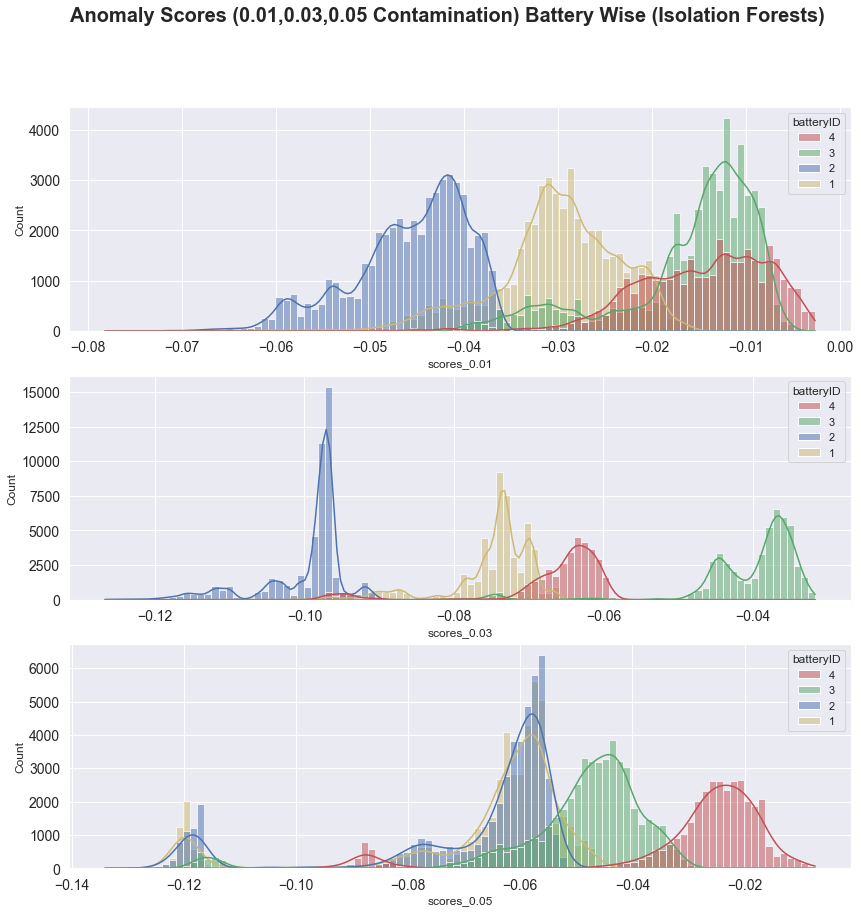

In [85]:
plt.figure(figsize=(15,6))
fig1 , axes = plt.subplots(nrows=3,ncols=1 , figsize = (14,14))

axes[0] = sns.histplot(x = 'scores_0.01',hue = 'batteryID', palette=['r','g','b','y'], data = flag_df_final, bins = 100, kde = True,ax = axes[0])

axes[1] = sns.histplot(x = 'scores_0.03',hue = 'batteryID', palette=['r','g','b','y'], data = flag_df_final, bins = 100, kde = True,ax = axes[1])

axes[2] = sns.histplot(x = 'scores_0.05',hue = 'batteryID', palette=['r','g','b','y'], data = flag_df_final, bins = 100, kde = True,ax = axes[2])

fig1.suptitle('Anomaly Scores (0.01,0.03,0.05 Contamination) Battery Wise (Isolation Forests)', fontsize = 20, fontweight = 'bold')
plt.show()

In [91]:
flag_df_final[flag_df_final['anomaly_score_0.03']==-1]['batteryID'].value_counts()

3    1509
2    1509
1    1509
4    1046
Name: batteryID, dtype: int64

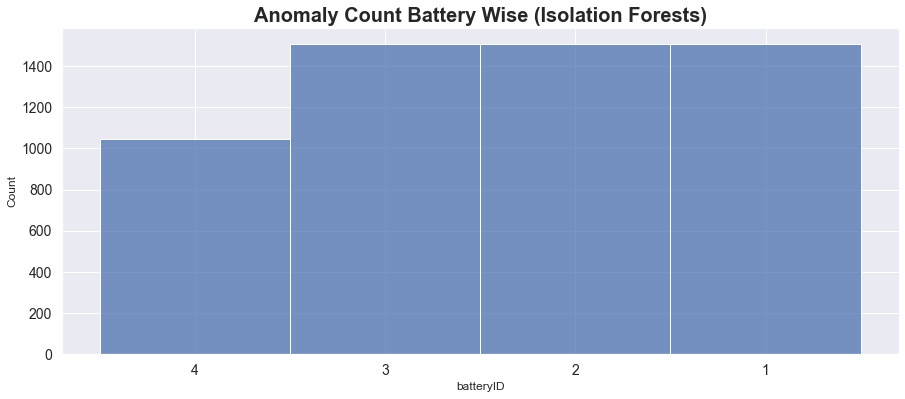

In [92]:
# Anomaly Count plot
plt.figure(figsize=(15,6))
sns.histplot(flag_df_final[flag_df_final['anomaly_score_0.03'] == -1]['batteryID'],stat = "count")
plt.title('Anomaly Count Battery Wise (Isolation Forests)', fontsize = 20, fontweight = 'bold')
plt.show()

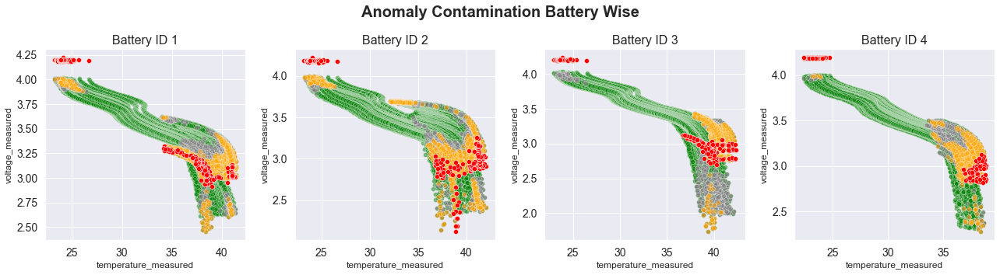

In [88]:
fig, axs = plt.subplots(1, 4, figsize = (18,5))
for i in range(5):
    if(i==0):
        continue
    sns.scatterplot(data = flag_df_final[(flag_df_final['anomaly_score_0.01'] == 1) & (flag_df_final['batteryID'] == str(i))],
                   x = 'temperature_measured', y = 'voltage_measured', alpha = 0.5,ax = axs[(i-1)],color="green")
    
    sns.scatterplot(data = flag_df_final[(flag_df_final['anomaly_score_0.05'] == -1) & (flag_df_final['batteryID'] == str(i))],
                   x = 'temperature_measured', y = 'voltage_measured', alpha = 0.5,ax = axs[(i-1)],color="grey") 
    
    sns.scatterplot(data = flag_df_final[(flag_df_final['anomaly_score_0.03'] == -1) & (flag_df_final['batteryID'] == str(i))],
                   x = 'temperature_measured', y = 'voltage_measured', alpha = 0.5,ax = axs[(i-1)],color="orange")
    
    sns.scatterplot(data = flag_df_final[(flag_df_final['anomaly_score_0.01'] == -1) & (flag_df_final['batteryID'] == str(i))],
                   x = 'temperature_measured', y = 'voltage_measured', alpha = 1,ax = axs[(i-1)],color="red")
    
    axs[i-1].set_title('Battery ID ' + str(i), fontsize = 16)

fig.suptitle('Anomaly Contamination Battery Wise', fontsize = 20, fontweight = 'bold')
plt.tight_layout()
plt.show()

In [89]:
# 3D Plot
flag_df_final['contamLabel'] = np.where((flag_df_final["anomaly_score_0.01"] == -1) , 0,np.where((flag_df_final["anomaly_score_0.03"] == -1) , 1,np.where((flag_df_final["anomaly_score_0.05"] == -1) , 2, 3) ) )
fig = px.scatter_3d(flag_df_final[flag_df_final['batteryID']=="1"], x='temperature_measured', y='voltage_measured', z='time',
              color='contamLabel',color_continuous_scale=['red','orange','grey','green'])
fig.show()
# x='voltage_measured', y='temperature_measured' capacity
# np.where((flag_df_final["anomaly_score_0.03"] == -1) , 1, )